In [2]:
import os
import sys

data_fitting_py_files_dir = os.path.abspath("../../py_files/")
sys.path.insert(0, data_fitting_py_files_dir)

helper_func_py_files_dir = os.path.abspath("../../../../vampires_on_sky_calibration/programs/py_files/")
sys.path.insert(0, helper_func_py_files_dir)

import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import minimize
import general
import data_plotting
import reading_data
import instrument_matrices


In [3]:
HWP_angs = np.array([0., 11.25, 22.5, 33.75, 45., 56.25, 67.5, 78.75])
IMR_angs = np.array([45., 57.5, 70., 82.5, 95., 107.5, 120., 132.5])
wavelengths = np.array([625, 675, 725, 750, 775])
angles = [HWP_angs, IMR_angs]

In [4]:
# Last index is for choosing the wavelength

wavelength_index = 3
wavelength = 750

double_differences = np.load("../../../data/20230914/double_diffs_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
double_sums = np.load("../../../data/20230914/double_sums_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
double_difference_errs = np.load("../../../data/20230914/double_diff_stds_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
double_sum_errs = np.load("../../../data/20230914/double_sum_stds_20230914.npy")[0 : 8, 0 : 8, wavelength_index]
data = np.array([double_differences, double_sums])
stds = np.array([double_difference_errs, double_sum_errs])

reshaped_data = general.reshape_and_flatten(data)
reshaped_stds = general.reshape_and_flatten(stds)

In [5]:
# NOTE: Customized angle bounds for each parameter
IMR_angle_bound = 1
LP_angle_bound = 5
HWP_angle_bound = 5
FLC_angle_bound = (-5, 5)

bounds = ((0, 1), # EM Gain Ratio
          (-1 * LP_angle_bound, LP_angle_bound), # linear polarizer angle (degrees)
          (-1, 1), # delta_FLC (waves)
          (-1, 1), # delta_opt (waves)
          (-1, 1), # delta_derot (waves)
          (0, 0.499999), # delta_HWP (waves)
          FLC_angle_bound, # rot_FLC (degrees)
          (-90, 90), # rot_opt (degrees)
          (-1 * IMR_angle_bound, IMR_angle_bound), # offset_derot (degrees)
          (-1 * HWP_angle_bound, HWP_angle_bound), # offset_HWP (degrees)
          (0, 1)) # epsilon_opt (unitless)

# Plot Initial Guess

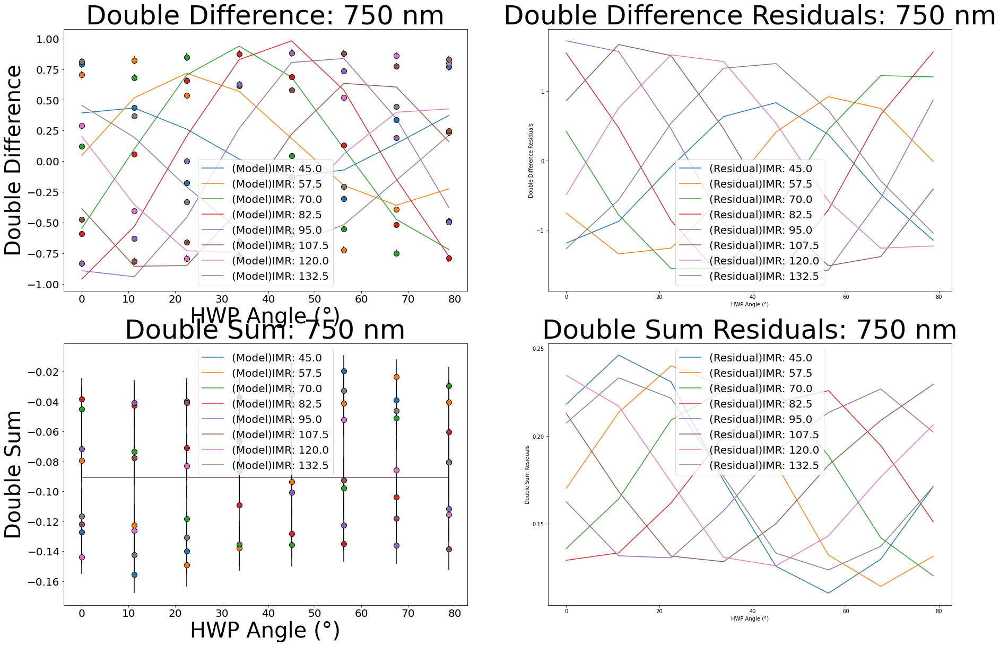

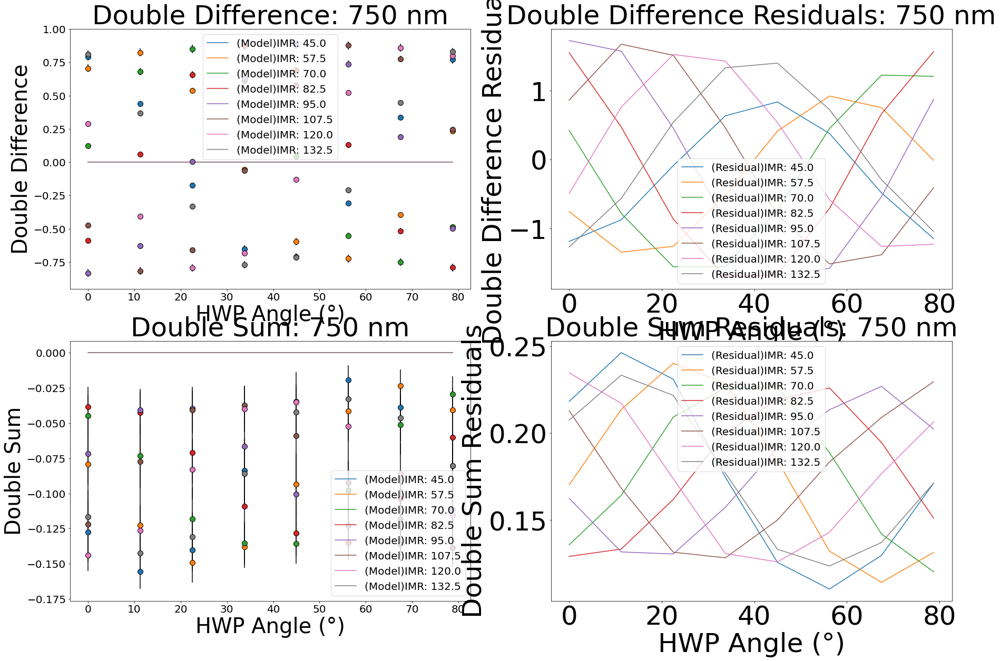

In [6]:
# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# Choosing matrix model
model = instrument_matrices.full_system_mueller_matrix

# Based on values in Six_And_Eleven_Parameter_Model_Best_MCMC_and_Scipy_Fits - having zeros for angles that're too large
theta_pol = 0
delta_m3 = 0 # (waves) - assumed to be a perfect mirror for now
epsilon_m3 = 0  # Using the M3 diattenuation from :all_unpolarized_standards_matrix_inversion_m3_diatttenuation"
offset_m3 = 0  # NOTE: Made this zero too for testing purposes
em_gain = 1.2  # Add your actual em_gain value
delta_HWP = 0.451  # Add your actual delta_HWP value
offset_HWP = -2.642  # Add your actual offset_HWP value
delta_derot = 0.32  # Add your actual delta_derot value
offset_derot = 0  # Add your actual offset_derot value
delta_opts = 0  # Add your actual delta_opts value
epsilon_opts = 0  # Add your actual epsilon_opts value
rot_opts = 0  # Add your actual rot_opts value
delta_FLC = 0.5  # Add your actual delta_FLC value
rot_FLC = 0  # Add your actual rot_FLC value

initial_guess = np.array([ \
    theta_pol,
    delta_HWP,
    offset_HWP,
    delta_derot,
    offset_derot,
    delta_opts,
    epsilon_opts,
    rot_opts,
    delta_FLC,
    rot_FLC,
    em_gain
])

fixed_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Calculating initial model and residuals
initial_model = instrument_matrices.internal_calibration_mueller_matrix(theta_pol,
    model, fixed_params, HWP_angs, IMR_angs)
initial_residuals = initial_model - reshaped_data

# Plotting the initial model and residuals
data_plotting.plot_single_model_and_residuals(angles, angles, -initial_model, data, 
    initial_residuals, stds, log_f, wavelength, fig_dimensions = (30, 20))

# Plotting just the data with no model
data_plotting.plot_single_model_and_residuals(angles, angles, np.zeros(np.shape(initial_model)), data, 
    initial_residuals, stds, log_f, wavelength, fig_dimensions = (30, 20))

# Iterative Scipy Minimize

Initial Likelihood: 25908.20159203401
Iteration #1: 8033.873549292202
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 1.2244694275376125
delta_HWP (waves): 0.5
offset_HWP (degrees): 3.7565047077823372
delta_derot (waves): 0.41467700579883515
offset_derot (degrees): 0.9750708343103489
delta_opts (waves): 0.12300711668420655
epsilon_opts: 5.700754208195504e-05
rot_opts (degrees): 0.4315203446641107
delta_FLC (waves): 0.5
rot_FLC (degrees): 2.9878738888477123


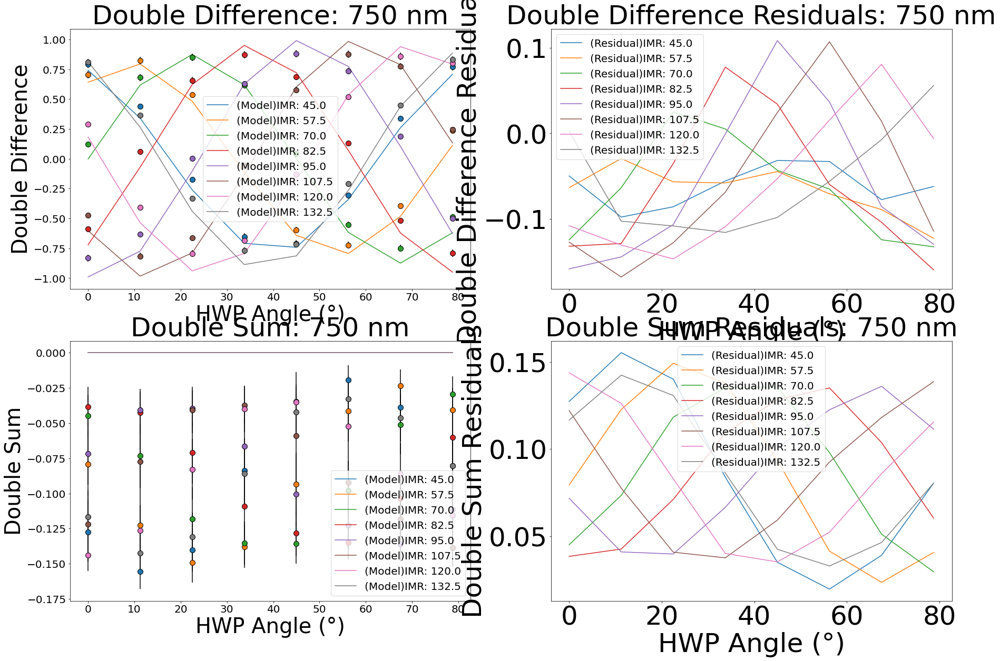

Post Likelihood: 8033.873549292202
Initial Likelihood: 3600.568621041445
Iteration #2: 8089.109781847759
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 4.990036169876439
delta_HWP (waves): 0.5
offset_HWP (degrees): 2.759309784398453
delta_derot (waves): 0.4102305906219873
offset_derot (degrees): 0.8913528925048912
delta_opts (waves): 0.0384762172687248
epsilon_opts: 0.0
rot_opts (degrees): 0.6757851433436428
delta_FLC (waves): 0.5
rot_FLC (degrees): 4.7987731874268444


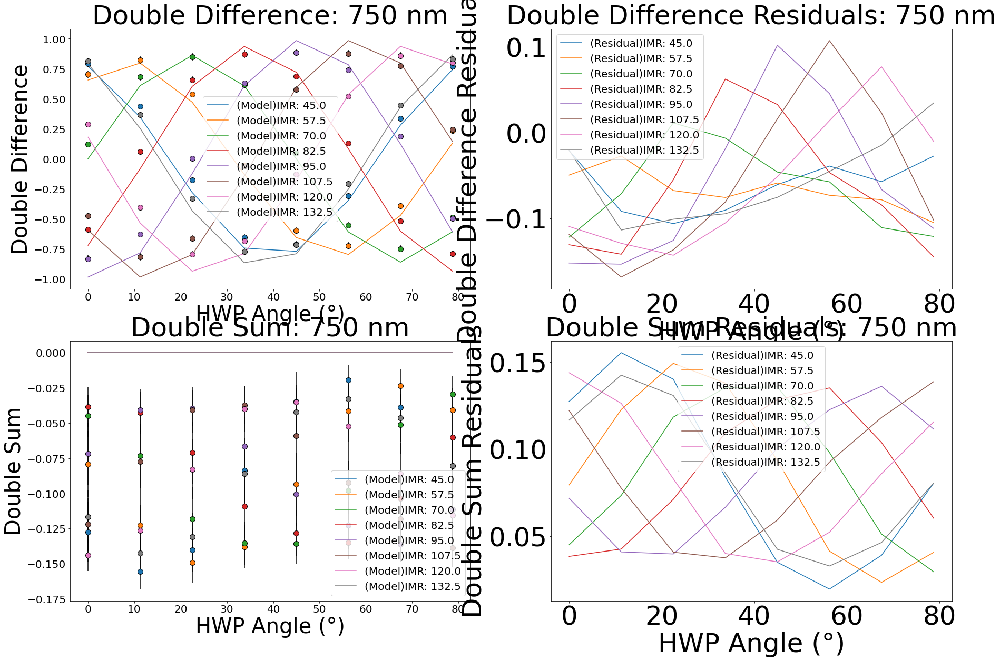

Post Likelihood: 8089.109781847759


In [13]:
import numpy as np
from scipy.optimize import minimize

# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# List to store all the solutions 
solns = []

# Initial guess based on the parameters you want to minimize
initial_guess = np.array([theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, 
    delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC])

all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Fixed parameters not included in the fitting process
fixed_params = [delta_m3, epsilon_m3, offset_m3, em_gain]

# Define the bounds for the parameters (excluding em_gain)
bounds = [
    (-5, 5),  # theta_pol
    (0, 0.5),  # delta_HWP
    (-5, 5),  # offset_HWP
    (0, 0.5),  # delta_derot
    (-5, 5),  # offset_derot
    (-0.5, 0.5),  # delta_opts
    (0, 0.1),  # epsilon_opts
    (-90, 90),  # rot_opts
    (0, 0.5),  # delta_FLC
    (-90, 90)  # rot_FLC
]

# Defining the negative log-likelihood function
def nll(params, model, HWP_angs, IMR_angs, data, stds):
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC = params
    delta_m3, epsilon_m3, offset_m3, em_gain = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    this_model = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals = this_model - data
    
    # Debug print shapes
    # print("Model shape:", this_model.shape)
    # print("Data shape:", data.shape)
    # print("Stds shape:", stds.shape)
    
    likelihood = np.sum((residuals / stds) ** 2)
    return likelihood

# Initialize variables for the iterative minimization process
counter = 0
initial_likelihood = 100
post_likelihood = 90

# Starting off with the initial guess
model = instrument_matrices.full_system_mueller_matrix
initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)

while post_likelihood < initial_likelihood:
    counter += 1

    initial_likelihood = post_likelihood

    # Calculate the initial model and residuals
    initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)
    initial_residuals = initial_model - reshaped_data

    initial_likelihood = np.sum((initial_residuals / reshaped_stds) ** 2)

    print("Initial Likelihood: " + str(initial_likelihood))

    # Minimize the negative log-likelihood
    minimize_args = (model, HWP_angs, IMR_angs, reshaped_data, reshaped_stds)
    soln = minimize(nll, initial_guess, args=minimize_args, bounds=bounds, method="Nelder-Mead")

    # Save the solution
    solns.append(soln)

    # Recalculate the likelihood with the new solution
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC = soln.x
    delta_m3, epsilon_m3, offset_m3, em_gain = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    post_likelihood = np.sum((-instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs) - reshaped_data) / reshaped_stds ** 2)

    print("Iteration #" + str(counter) + ": " + str(post_likelihood))

    print("MAXIMUM LIKELIHOOD ESTIMATES")
    print("")
    print("theta_pol (degrees): " + str(theta_pol))
    print("delta_HWP (waves): " + str(delta_HWP))
    print("offset_HWP (degrees): " + str(offset_HWP))
    print("delta_derot (waves): " + str(delta_derot))
    print("offset_derot (degrees): " + str(offset_derot))
    print("delta_opts (waves): " + str(delta_opts))
    print("epsilon_opts: " + str(epsilon_opts))
    print("rot_opts (degrees): " + str(rot_opts))
    print("delta_FLC (waves): " + str(delta_FLC))
    print("rot_FLC (degrees): " + str(rot_FLC))

    reshaped_data = general.reshape_and_flatten(data)
    reshaped_stds = general.reshape_and_flatten(stds)

    model_1 = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals_1 = model_1 - reshaped_data

    data_plotting.plot_single_model_and_residuals(angles, angles, model_1, data, 
        residuals_1, stds, log_f, wavelength, fig_dimensions = (30, 20))

    # Reset initial guess
    initial_guess = soln.x

    print("Post Likelihood: " + str(post_likelihood))


# Iterative scipy.minimize with looser bounds and only double diffs

Initial Likelihood: 3565.261603052586
Iteration #1: 7534.717004314523
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 5.0
delta_HWP (waves): 0.5
offset_HWP (degrees): 1.1396725871962263
delta_derot (waves): 0.4387289184776655
offset_derot (degrees): -2.7537038093355815
delta_opts (waves): 0.07803920651893767
epsilon_opts: 0.0
rot_opts (degrees): 24.49759396099553
delta_FLC (waves): 0.3580407956799978
rot_FLC (degrees): 4.000388812815716


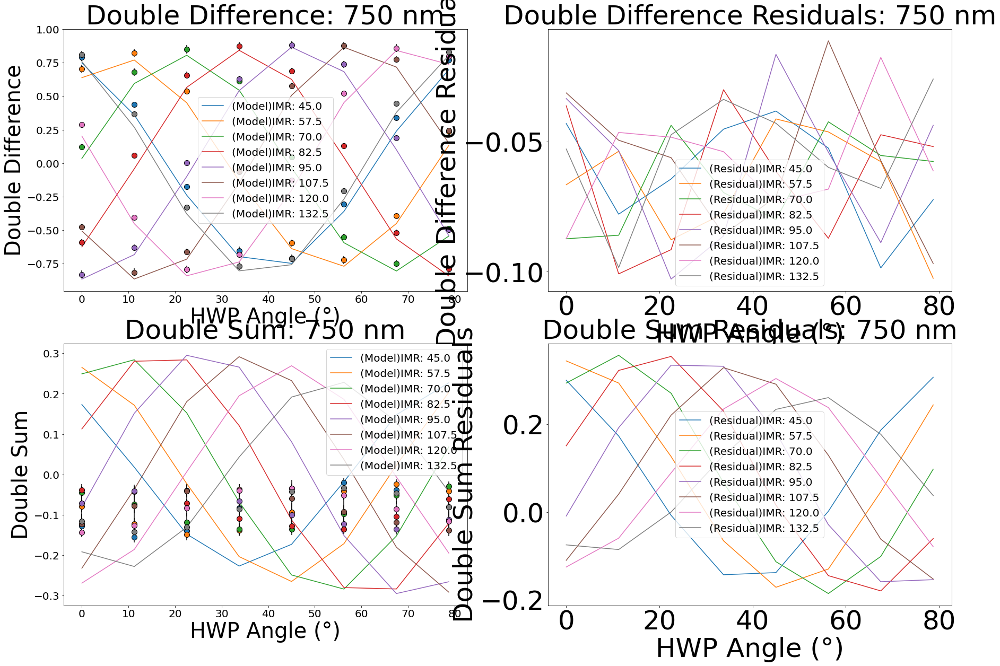

Post Likelihood: 7534.717004314523


In [14]:
import numpy as np
from scipy.optimize import minimize

# Assuming the function sum_and_diff_separation is imported from general
# from general import sum_and_diff_separation

# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# List to store all the solutions 
solns = []

# Initial guess based on the parameters you want to minimize
initial_guess = np.array([theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, 
    delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC])

all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Fixed parameters not included in the fitting process
fixed_params = [delta_m3, epsilon_m3, offset_m3, em_gain]

# Define the bounds for the parameters (excluding em_gain)
bounds = [
    (-5, 5),  # theta_pol
    (0, 0.5),  # delta_HWP
    (-5, 5),  # offset_HWP
    (0, 1),  # delta_derot
    (-5, 5),  # offset_derot
    (-0.5, 0.5),  # delta_opts
    (0, 0.1),  # epsilon_opts
    (-90, 90),  # rot_opts
    (-1, 1),  # delta_FLC
    (-90, 90)  # rot_FLC
]

# Defining the negative log-likelihood function
def nll(params, model, HWP_angs, IMR_angs, data, stds):
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC = params
    delta_m3, epsilon_m3, offset_m3, em_gain = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    this_model = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    model_diff, _ = general.sum_and_diff_separation(this_model)
    data_diff, _ = general.sum_and_diff_separation(data)
    stds_diff, _ = general.sum_and_diff_separation(stds)
    
    residuals = model_diff - data_diff
    likelihood = np.sum((residuals / stds_diff) ** 2)
    return likelihood

# Initialize variables for the iterative minimization process
counter = 0
initial_likelihood = 100
post_likelihood = 90

# Starting off with the initial guess
model = instrument_matrices.full_system_mueller_matrix
initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)

while post_likelihood < initial_likelihood:
    counter += 1

    initial_likelihood = post_likelihood

    # Calculate the initial model and residuals
    initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)
    initial_residuals = initial_model - reshaped_data

    initial_likelihood = np.sum((initial_residuals / reshaped_stds) ** 2)

    print("Initial Likelihood: " + str(initial_likelihood))

    # Minimize the negative log-likelihood
    minimize_args = (model, HWP_angs, IMR_angs, reshaped_data, reshaped_stds)
    soln = minimize(nll, initial_guess, args=minimize_args, bounds=bounds, method="Nelder-Mead")

    # Save the solution
    solns.append(soln)

    # Recalculate the likelihood with the new solution
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC = soln.x
    delta_m3, epsilon_m3, offset_m3, em_gain = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    post_likelihood = np.sum((-instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs) - reshaped_data) / reshaped_stds ** 2)

    print("Iteration #" + str(counter) + ": " + str(post_likelihood))

    print("MAXIMUM LIKELIHOOD ESTIMATES")
    print("")
    print("theta_pol (degrees): " + str(theta_pol))
    print("delta_HWP (waves): " + str(delta_HWP))
    print("offset_HWP (degrees): " + str(offset_HWP))
    print("delta_derot (waves): " + str(delta_derot))
    print("offset_derot (degrees): " + str(offset_derot))
    print("delta_opts (waves): " + str(delta_opts))
    print("epsilon_opts: " + str(epsilon_opts))
    print("rot_opts (degrees): " + str(rot_opts))
    print("delta_FLC (waves): " + str(delta_FLC))
    print("rot_FLC (degrees): " + str(rot_FLC))

    reshaped_data = general.reshape_and_flatten(data)
    reshaped_stds = general.reshape_and_flatten(stds)

    model_1 = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals_1 = model_1 - reshaped_data

    data_plotting.plot_single_model_and_residuals(angles, angles, model_1, data, 
        residuals_1, stds, log_f, wavelength, fig_dimensions = (30, 20))

    # Reset initial guess
    initial_guess = soln.x

    print("Post Likelihood: " + str(post_likelihood))


# Iterative fitting that includes the EM Gain

Initial Likelihood: 9600.244078211575
Iteration #1: -12277.873762059044
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 5.0
delta_HWP (waves): 0.5
offset_HWP (degrees): 1.178009545055067
delta_derot (waves): 0.5
offset_derot (degrees): -1.5067934219814396
delta_opts (waves): 0.08559359964453969
epsilon_opts: 0.0
rot_opts (degrees): 40.496370430751654
delta_FLC (waves): 0.3323525110784683
rot_FLC (degrees): 4.233320401282877
em_gain: 1.18727452205871


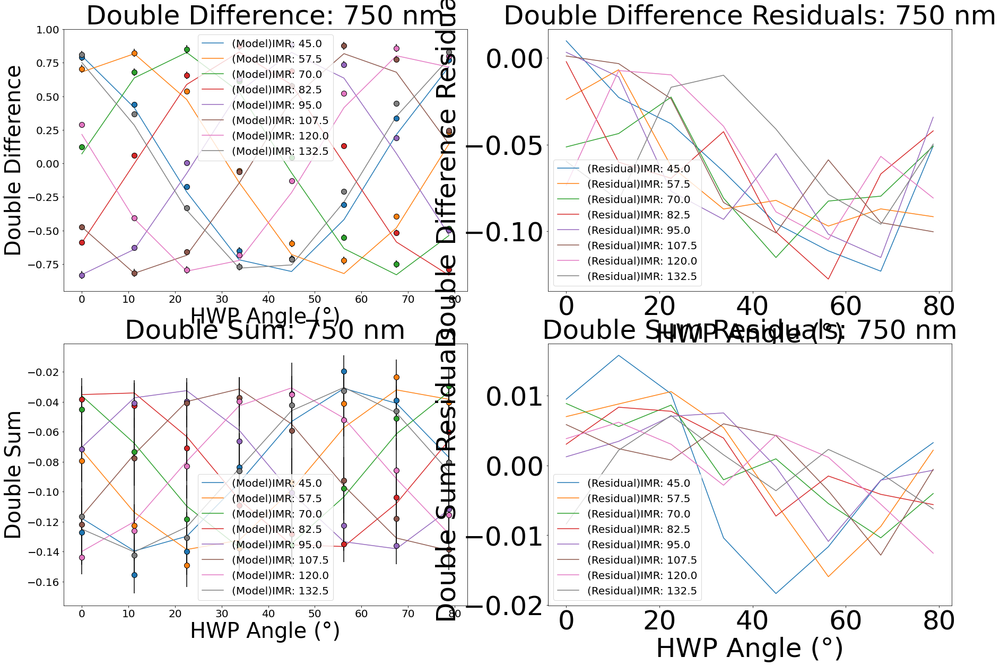

Post Likelihood: -12277.873762059044
Initial Likelihood: 1106.8733283328943
Iteration #2: -12277.873762059044
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 5.0
delta_HWP (waves): 0.5
offset_HWP (degrees): 1.178009545055067
delta_derot (waves): 0.5
offset_derot (degrees): -1.5067934219814396
delta_opts (waves): 0.08559359964453969
epsilon_opts: 0.0
rot_opts (degrees): 40.496370430751654
delta_FLC (waves): 0.3323525110784683
rot_FLC (degrees): 4.233320401282877
em_gain: 1.18727452205871


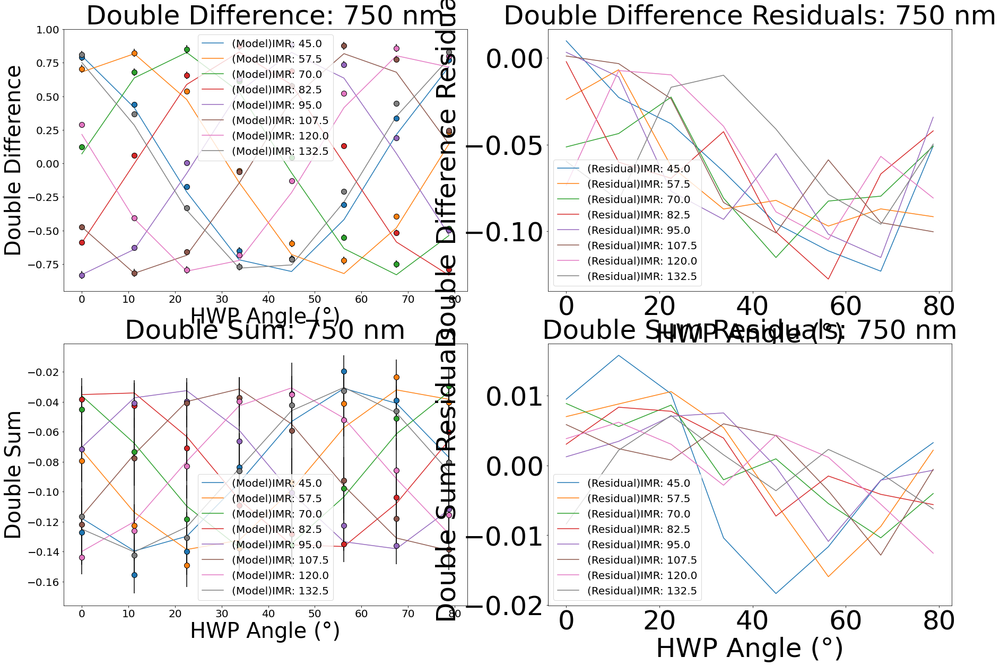

Post Likelihood: -12277.873762059044
Initial Likelihood: 1106.8733283328943
Iteration #3: -12277.873762059044
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): 5.0
delta_HWP (waves): 0.5
offset_HWP (degrees): 1.178009545055067
delta_derot (waves): 0.5
offset_derot (degrees): -1.5067934219814396
delta_opts (waves): 0.08559359964453969
epsilon_opts: 0.0
rot_opts (degrees): 40.496370430751654
delta_FLC (waves): 0.3323525110784683
rot_FLC (degrees): 4.233320401282877
em_gain: 1.18727452205871


In [15]:
import numpy as np
from scipy.optimize import minimize

# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# List to store all the solutions 
solns = []

# Initial guess based on the parameters you want to minimize
initial_guess = np.array([theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, 
    delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain])

all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Fixed parameters not included in the fitting process
fixed_params = [delta_m3, epsilon_m3, offset_m3]

# Define the bounds for the parameters (including em_gain)
bounds = [
    (-5, 5),  # theta_pol
    (0, 0.5),  # delta_HWP
    (-5, 5),  # offset_HWP
    (0, 0.5),  # delta_derot
    (-5, 5),  # offset_derot
    (-0.5, 0.5),  # delta_opts
    (0, 0.1),  # epsilon_opts
    (-90, 90),  # rot_opts
    (0, 0.5),  # delta_FLC
    (-90, 90),  # rot_FLC
    (0, 2)  # em_gain
]

# Defining the negative log-likelihood function
def nll(params, model, HWP_angs, IMR_angs, data, stds):
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain = params
    delta_m3, epsilon_m3, offset_m3 = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    this_model = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals = this_model - data
    
    # Debug print shapes
    # print("Model shape:", this_model.shape)
    # print("Data shape:", data.shape)
    # print("Stds shape:", stds.shape)
    
    likelihood = np.sum((residuals / stds) ** 2)
    return likelihood

# Initialize variables for the iterative minimization process
counter = 0
initial_likelihood = 100
post_likelihood = 90

# Starting off with the initial guess
model = instrument_matrices.full_system_mueller_matrix
initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)

while post_likelihood < initial_likelihood:
    counter += 1

    initial_likelihood = post_likelihood

    # Calculate the initial model and residuals
    initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)
    initial_residuals = initial_model - reshaped_data

    initial_likelihood = np.sum((initial_residuals / reshaped_stds) ** 2)

    print("Initial Likelihood: " + str(initial_likelihood))

    # Minimize the negative log-likelihood
    minimize_args = (model, HWP_angs, IMR_angs, reshaped_data, reshaped_stds)
    soln = minimize(nll, initial_guess, args=minimize_args, bounds=bounds, method="Nelder-Mead")

    # Save the solution
    solns.append(soln)

    # Recalculate the likelihood with the new solution
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain = soln.x
    delta_m3, epsilon_m3, offset_m3 = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    post_likelihood = np.sum((-instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs) - reshaped_data) / reshaped_stds ** 2)

    print("Iteration #" + str(counter) + ": " + str(post_likelihood))

    print("MAXIMUM LIKELIHOOD ESTIMATES")
    print("")
    print("theta_pol (degrees): " + str(theta_pol))
    print("delta_HWP (waves): " + str(delta_HWP))
    print("offset_HWP (degrees): " + str(offset_HWP))
    print("delta_derot (waves): " + str(delta_derot))
    print("offset_derot (degrees): " + str(offset_derot))
    print("delta_opts (waves): " + str(delta_opts))
    print("epsilon_opts: " + str(epsilon_opts))
    print("rot_opts (degrees): " + str(rot_opts))
    print("delta_FLC (waves): " + str(delta_FLC))
    print("rot_FLC (degrees): " + str(rot_FLC))
    print("em_gain: " + str(em_gain))

    reshaped_data = general.reshape_and_flatten(data)
    reshaped_stds = general.reshape_and_flatten(stds)

    model_1 = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals_1 = model_1 - reshaped_data

    data_plotting.plot_single_model_and_residuals(angles, angles, model_1, data, 
        residuals_1, stds, log_f, wavelength, fig_dimensions = (30, 20))

    # Reset initial guess
    initial_guess = soln.x

    print("Post Likelihood: " + str(post_likelihood))


# Trying FLC behaviour ~ half-wave retardance

Initial Likelihood: 24203.17419185138
Iteration #1: 1310.9520493402542
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -0.36856389405479506
delta_HWP (waves): 0.46599556994047475
offset_HWP (degrees): 3.7087285936242598
delta_derot (waves): 0.49418314177797007
offset_derot (degrees): 4.09939476602618
delta_opts (waves): 0.13238139020782014
epsilon_opts: 0.0010060396172652164
rot_opts (degrees): -3.800043850344707
delta_FLC (waves): 0.48784900101658923
rot_FLC (degrees): 6.668235919017647
em_gain: 1.1411323691555433


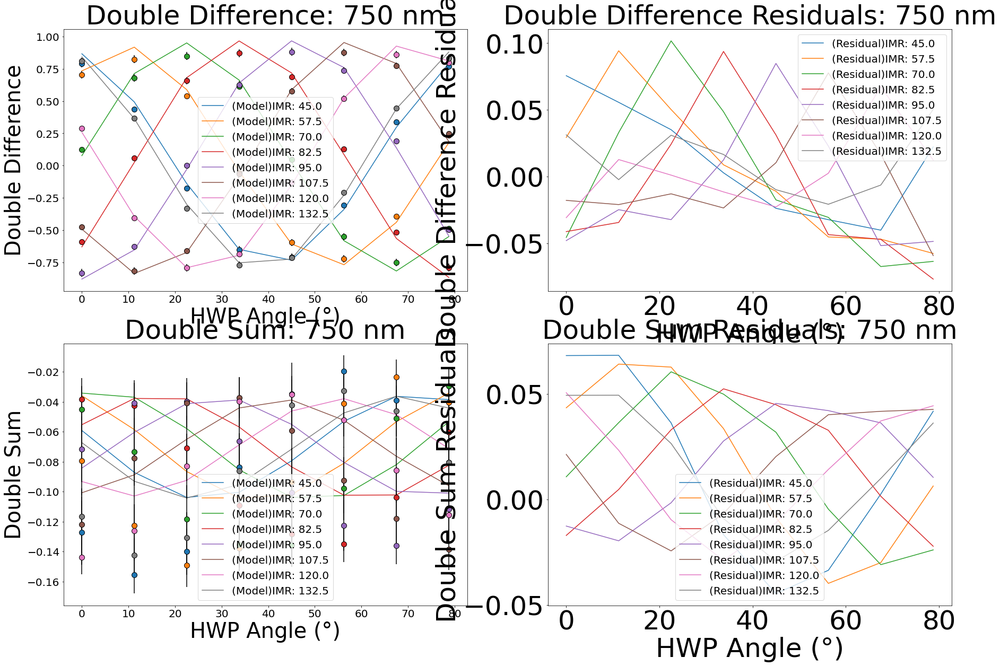

Post Likelihood: 1310.9520493402542
Initial Likelihood: 551.9826711786932
Iteration #2: -1145.1231347708772
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -3.6501241763443337
delta_HWP (waves): 0.46678646395475387
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4906685963245365
offset_derot (degrees): 2.9539423627062886
delta_opts (waves): 0.345899355092965
epsilon_opts: 0.0021084849717820245
rot_opts (degrees): 31.128301498761445
delta_FLC (waves): 0.4850697389709725
rot_FLC (degrees): 24.48471949338922
em_gain: 1.1987351176954801


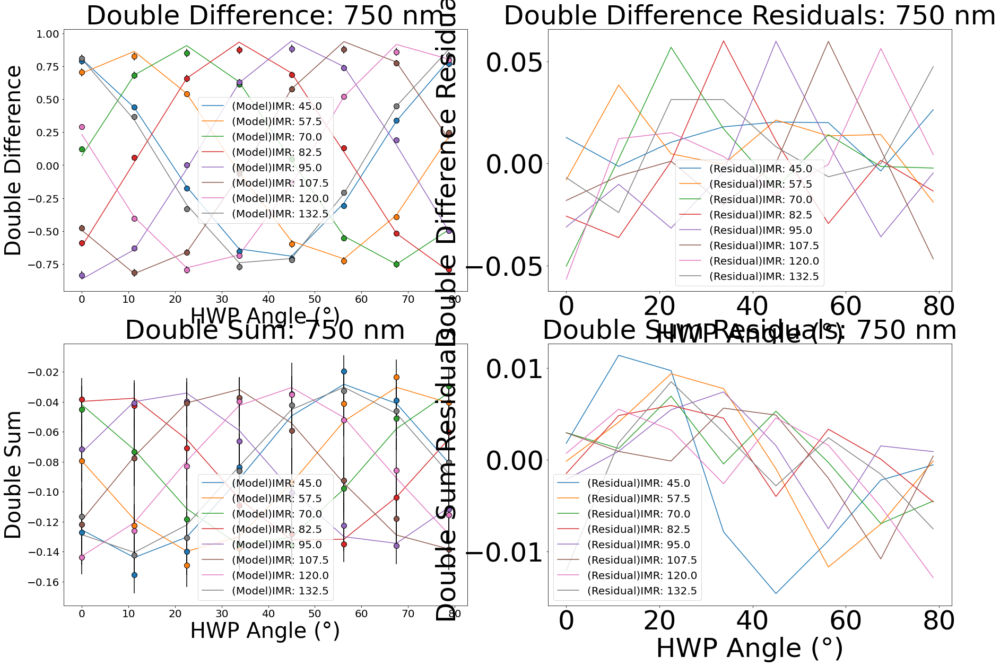

Post Likelihood: -1145.1231347708772
Initial Likelihood: 124.65647828457878
Iteration #3: -1025.5095255950055
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -4.814815364572773
delta_HWP (waves): 0.4678146155964098
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886903974101263
offset_derot (degrees): 4.996687391353218
delta_opts (waves): 0.3409436455761926
epsilon_opts: 8.193609661124934e-08
rot_opts (degrees): 33.40060588360767
delta_FLC (waves): 0.484872624128427
rot_FLC (degrees): 25.50320208368546
em_gain: 1.1992024017033565


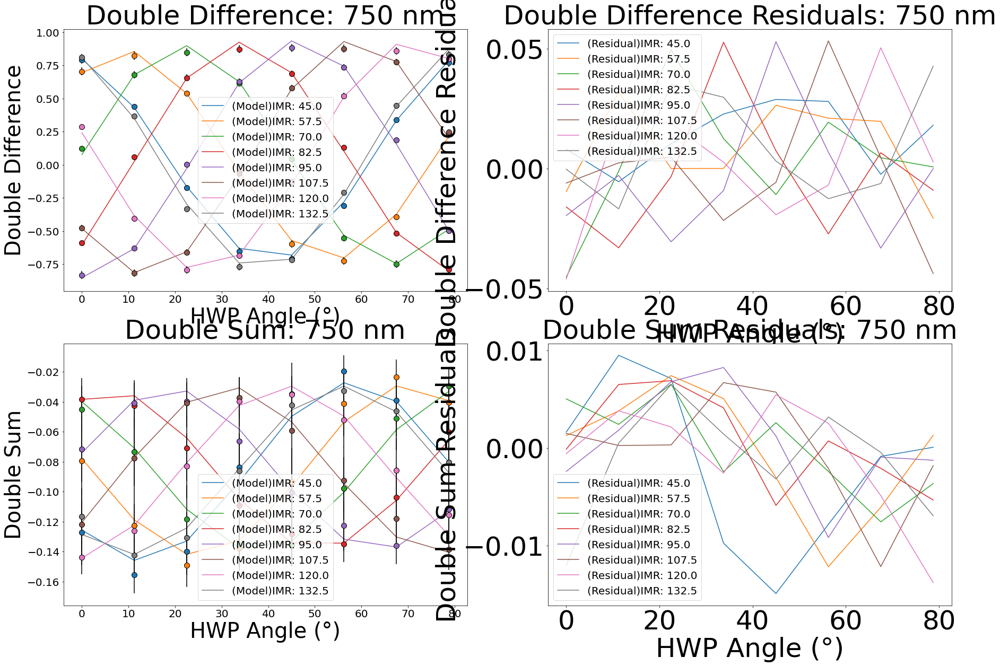

Post Likelihood: -1025.5095255950055
Initial Likelihood: 109.53387659902637
Iteration #4: -1020.0694048955969
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -4.996583199319965
delta_HWP (waves): 0.46781064582210197
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48866358494045464
offset_derot (degrees): 4.999972573961466
delta_opts (waves): 0.3489391028926475
epsilon_opts: 5.557313832430835e-08
rot_opts (degrees): 34.40153758117111
delta_FLC (waves): 0.4843200776363573
rot_FLC (degrees): 26.330181568347825
em_gain: 1.200683545324764


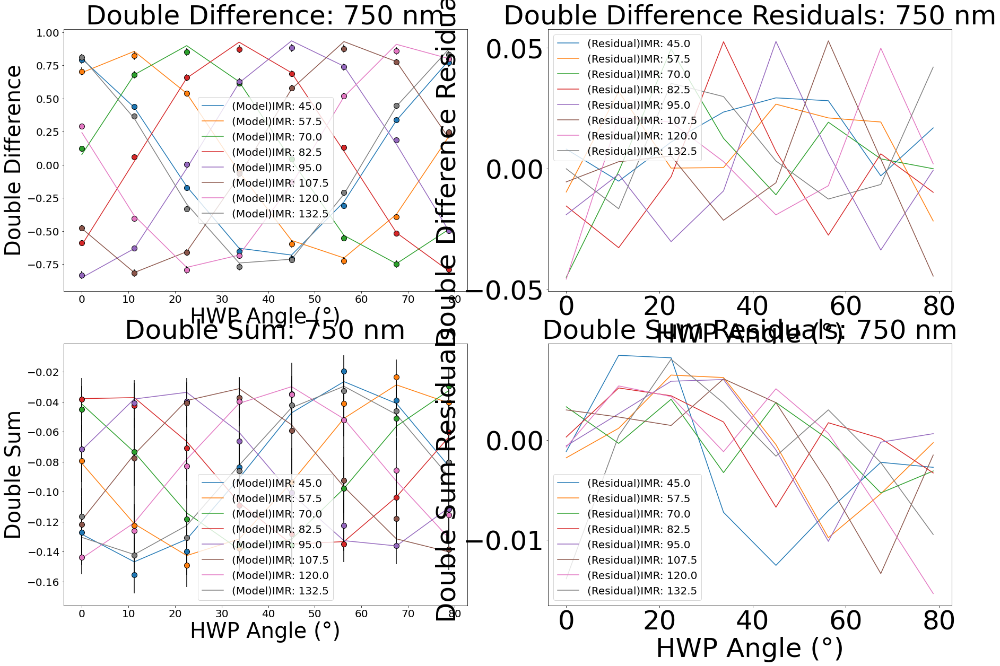

Post Likelihood: -1020.0694048955969
Initial Likelihood: 108.70865866489589
Iteration #5: -1013.2597402807068
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678276026682323
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865538046665064
offset_derot (degrees): 4.999977070154057
delta_opts (waves): 0.34897618113868145
epsilon_opts: 5.333488803723276e-08
rot_opts (degrees): 34.39998994328829
delta_FLC (waves): 0.4843147584922106
rot_FLC (degrees): 26.327665010579885
em_gain: 1.200521677125232


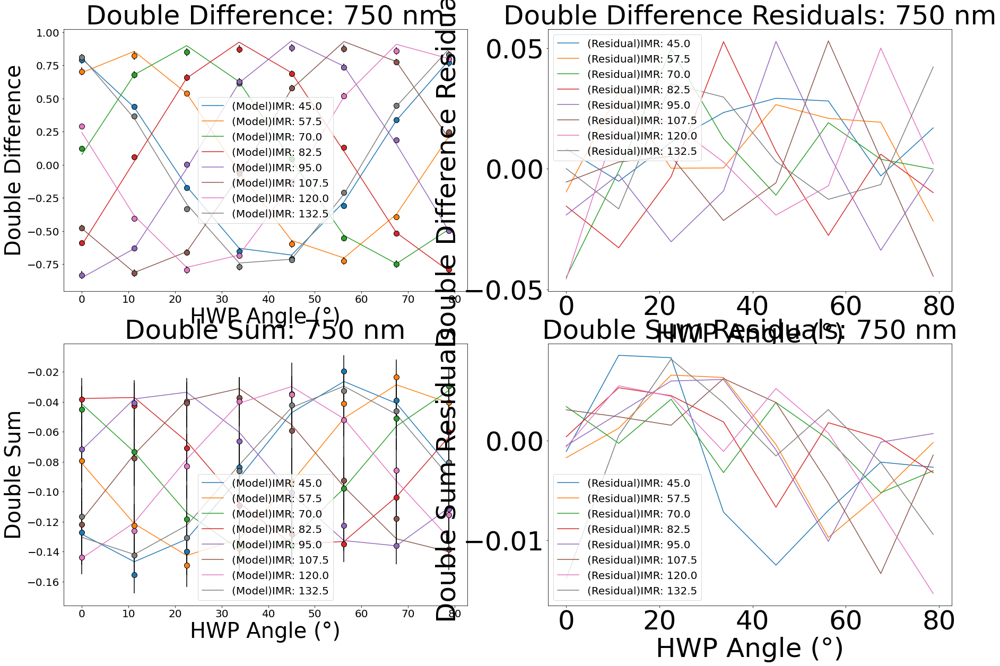

Post Likelihood: -1013.2597402807068
Initial Likelihood: 108.70152849142505
Iteration #6: -1014.1103896295406
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.467829085977973
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886548453344939
offset_derot (degrees): 4.999999651032223
delta_opts (waves): 0.34912663404066824
epsilon_opts: 1.7372877221419668e-11
rot_opts (degrees): 34.42281562199133
delta_FLC (waves): 0.4843038992098718
rot_FLC (degrees): 26.345608686112342
em_gain: 1.2005506942294484


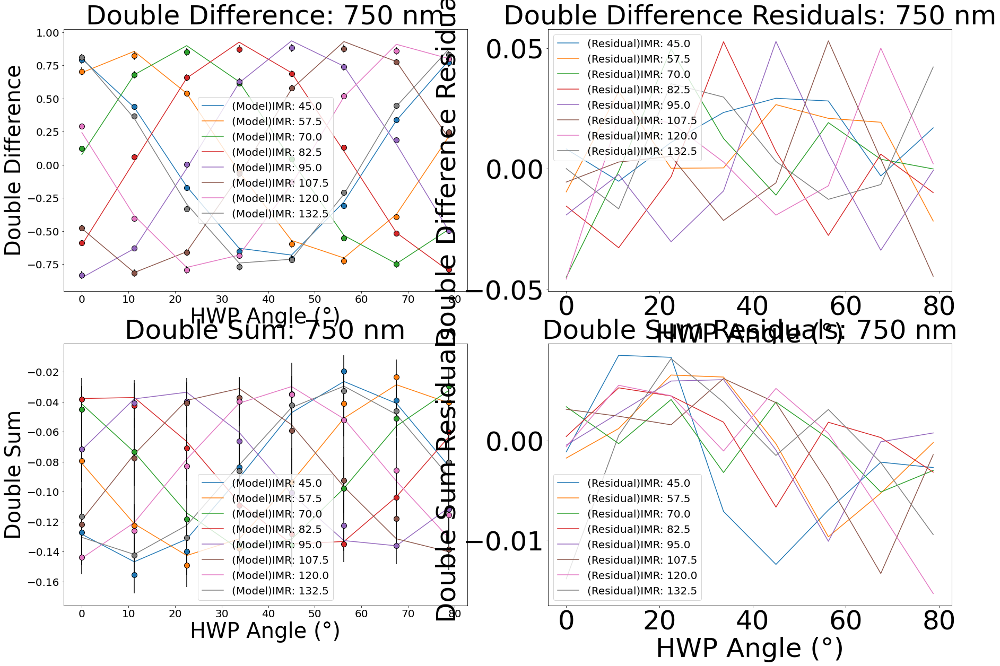

Post Likelihood: -1014.1103896295406
Initial Likelihood: 108.7011433409031
Iteration #7: -1013.8017312156367
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678284630046735
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886545594633148
offset_derot (degrees): 4.999999996078545
delta_opts (waves): 0.34912869721486284
epsilon_opts: 1.6802813494971454e-11
rot_opts (degrees): 34.4230245474963
delta_FLC (waves): 0.4843036250931748
rot_FLC (degrees): 26.345716878516242
em_gain: 1.2005496481713376


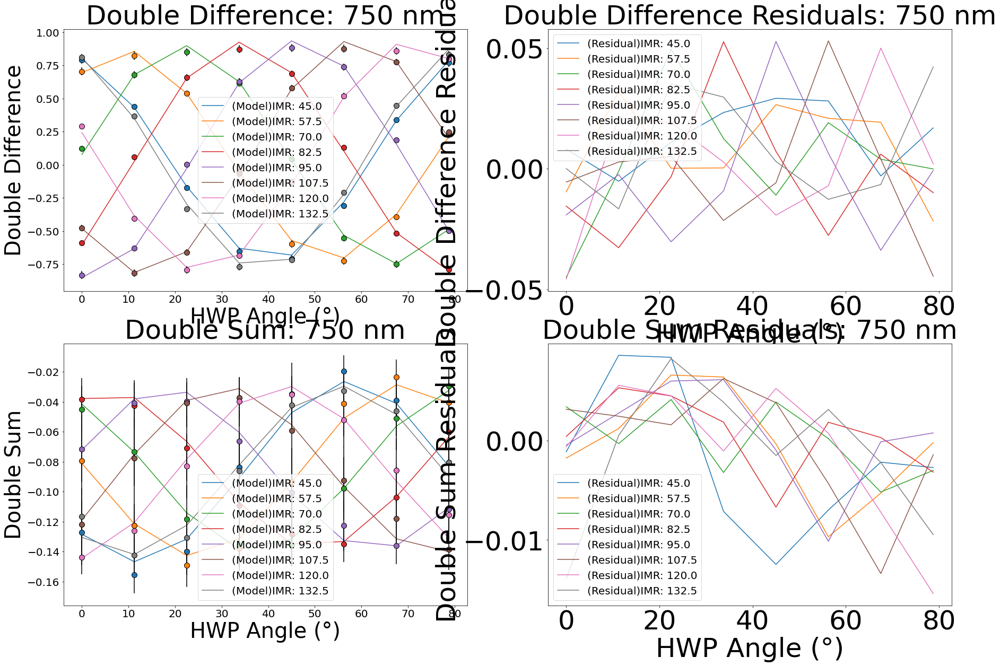

Post Likelihood: -1013.8017312156367
Initial Likelihood: 108.70114233839001
Iteration #8: -1013.7726430321424
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285724531539
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865446222641823
offset_derot (degrees): 4.999999996862767
delta_opts (waves): 0.349129001794855
epsilon_opts: 1.6970826984228574e-11
rot_opts (degrees): 34.42309271954208
delta_FLC (waves): 0.4843035161006203
rot_FLC (degrees): 26.345775803920205
em_gain: 1.200549273952427


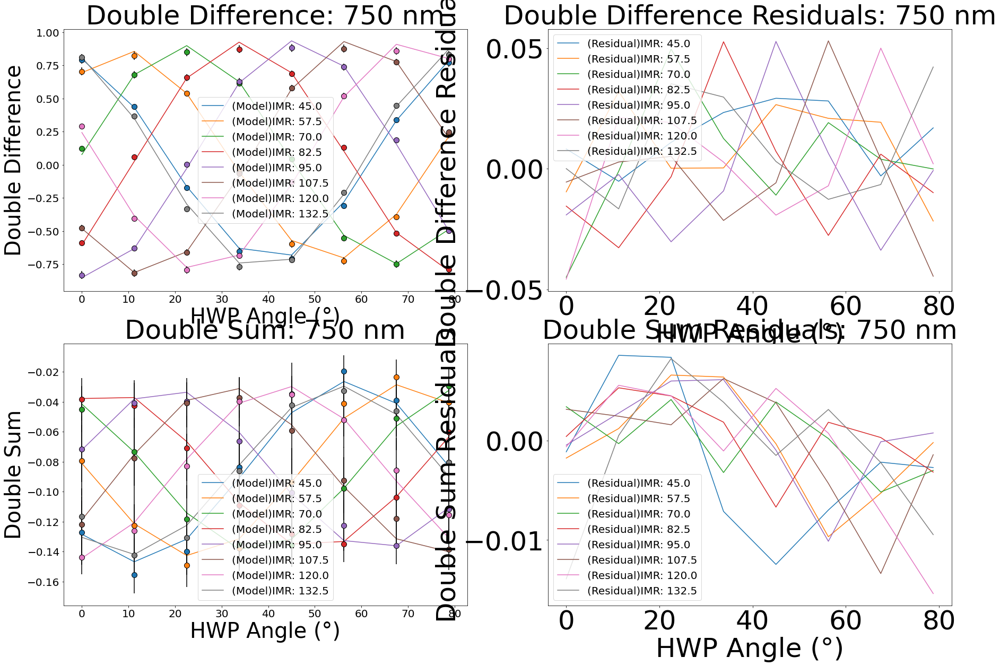

Post Likelihood: -1013.7726430321424
Initial Likelihood: 108.70114232441955
Iteration #9: -1013.7973843503318
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678284723264583
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886543821533562
offset_derot (degrees): 4.99999999749015
delta_opts (waves): 0.34912965752566383
epsilon_opts: 1.7140517796722937e-11
rot_opts (degrees): 34.42315912716873
delta_FLC (waves): 0.48430357789672174
rot_FLC (degrees): 26.34581414234338
em_gain: 1.2005496582465707


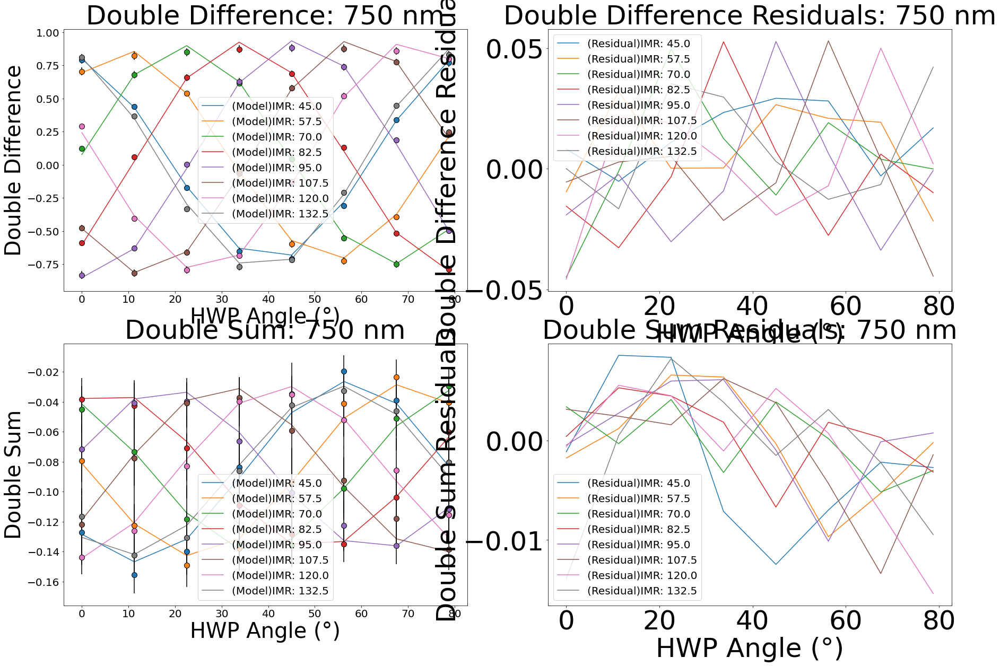

Post Likelihood: -1013.7973843503318
Initial Likelihood: 108.70114231524961
Iteration #10: -1013.7543933967885
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.46782844387749023
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886544145676282
offset_derot (degrees): 4.99999999799207
delta_opts (waves): 0.3491299676243006
epsilon_opts: 1.731190565256319e-11
rot_opts (degrees): 34.42322876523929
delta_FLC (waves): 0.4843034324909151
rot_FLC (degrees): 26.345875766219304
em_gain: 1.2005496833751537


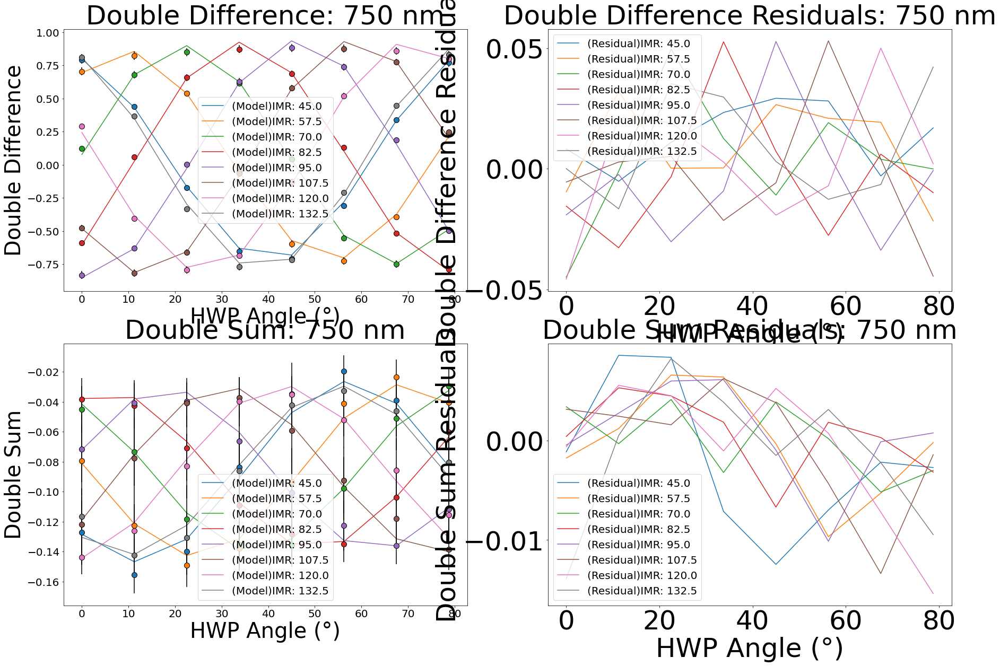

Post Likelihood: -1013.7543933967885
Initial Likelihood: 108.70114230430772
Iteration #11: -1013.8121683736672
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285114053313
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865452624216976
offset_derot (degrees): 4.999999998393634
delta_opts (waves): 0.3491302287906598
epsilon_opts: 1.7485015142262083e-11
rot_opts (degrees): 34.423252007264686
delta_FLC (waves): 0.4843034825436553
rot_FLC (degrees): 26.34588940616588
em_gain: 1.2005497821502646


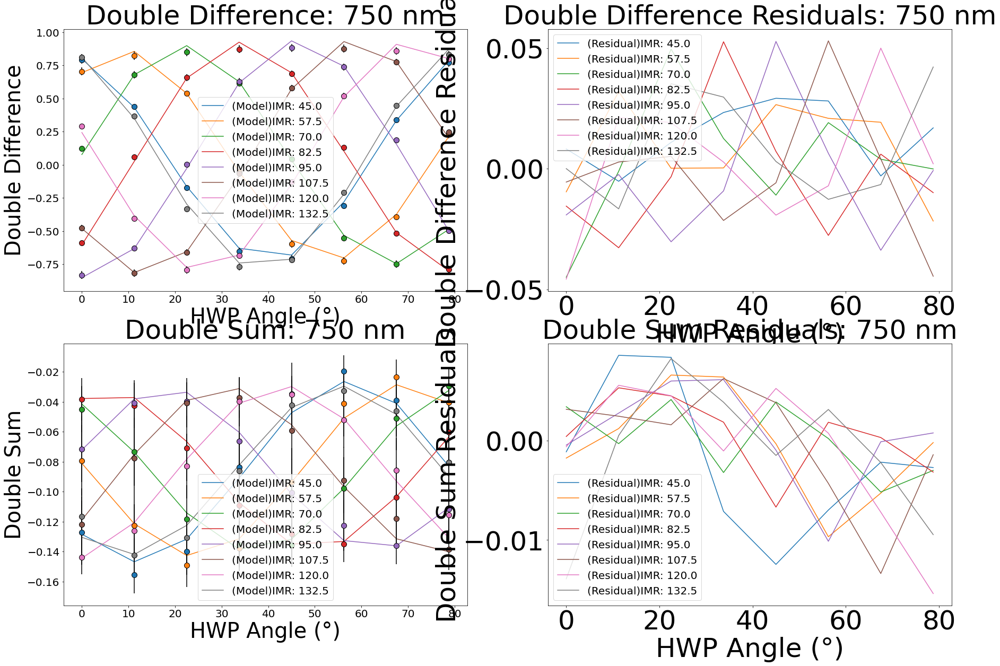

Post Likelihood: -1013.8121683736672
Initial Likelihood: 108.7011422899135
Iteration #12: -1013.747328981159
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.467828541111034
offset_HWP (degrees): -5.0
delta_derot (waves): 0.488654528387398
offset_derot (degrees): 4.99999999871489
delta_opts (waves): 0.3491304281177802
epsilon_opts: 1.7659856129068682e-11
rot_opts (degrees): 34.42329043453675
delta_FLC (waves): 0.48430347114197997
rot_FLC (degrees): 26.345926300895584
em_gain: 1.2005491622547613


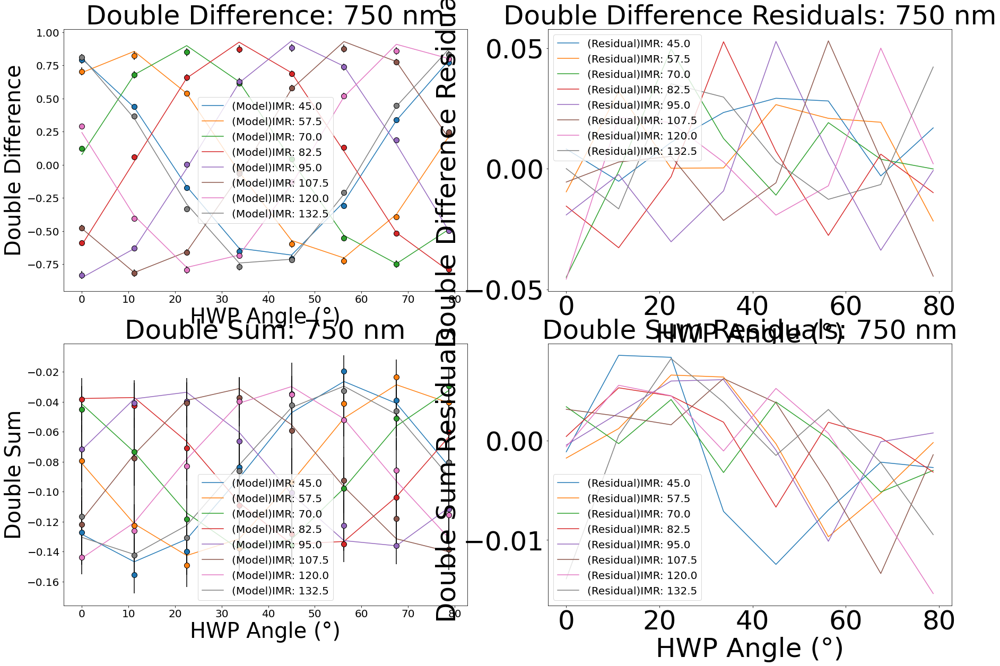

Post Likelihood: -1013.747328981159
Initial Likelihood: 108.70114228683397
Iteration #13: -1013.7904736060398
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.46782843065050467
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865441741557336
offset_derot (degrees): 4.9999999989718855
delta_opts (waves): 0.34913098939821774
epsilon_opts: 1.7836435031112787e-11
rot_opts (degrees): 34.4233623869767
delta_FLC (waves): 0.48430347064645274
rot_FLC (degrees): 26.3459760872178
em_gain: 1.2005500082618716


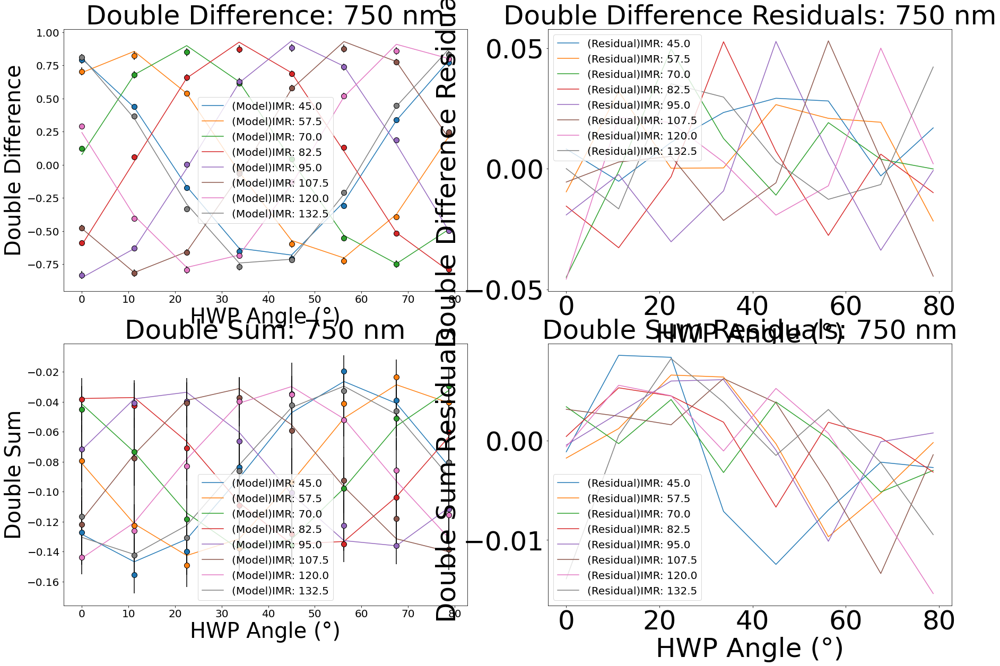

Post Likelihood: -1013.7904736060398
Initial Likelihood: 108.701142280336
Iteration #14: -1013.8087517429535
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285168077817
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865459251258847
offset_derot (degrees): 4.999999999177489
delta_opts (waves): 0.34913112128564633
epsilon_opts: 1.8014782334745123e-11
rot_opts (degrees): 34.42341293506584
delta_FLC (waves): 0.48430343005785514
rot_FLC (degrees): 26.346028641498492
em_gain: 1.2005500870720578


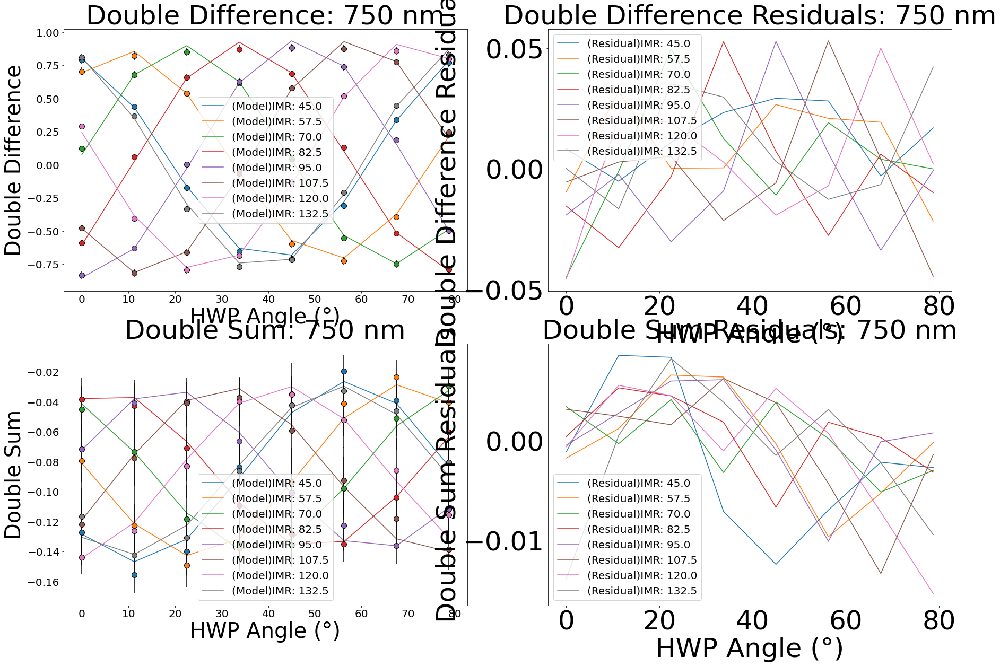

Post Likelihood: -1013.8087517429535
Initial Likelihood: 108.70114227261399
Iteration #15: -1013.8244463263363
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.46782857313543863
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886545701403173
offset_derot (degrees): 4.999999999341971
delta_opts (waves): 0.3491317738816138
epsilon_opts: 1.8194906535018493e-11
rot_opts (degrees): 34.423493968841484
delta_FLC (waves): 0.4843033635099232
rot_FLC (degrees): 26.34609288934438
em_gain: 1.2005500994819704


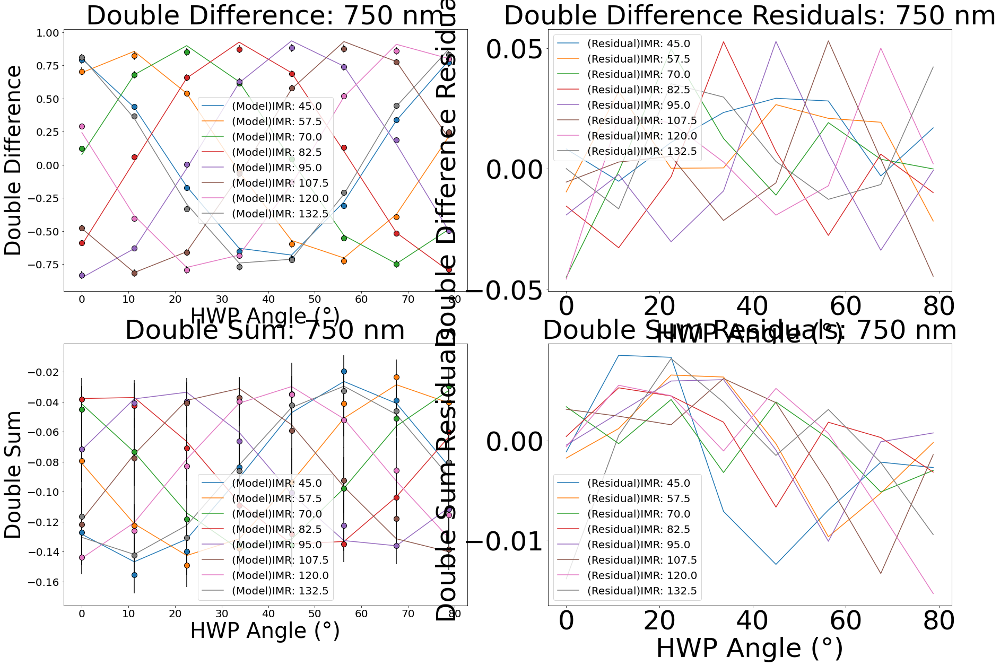

Post Likelihood: -1013.8244463263363
Initial Likelihood: 108.70114227053098
Iteration #16: -1013.824446375203
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.46782857313543863
offset_HWP (degrees): -5.0
delta_derot (waves): 0.4886545701403173
offset_derot (degrees): 5.0
delta_opts (waves): 0.3491317738816138
epsilon_opts: 1.8194906535018493e-11
rot_opts (degrees): 34.423493968841484
delta_FLC (waves): 0.4843033635099232
rot_FLC (degrees): 26.34609288934438
em_gain: 1.2005500994819704


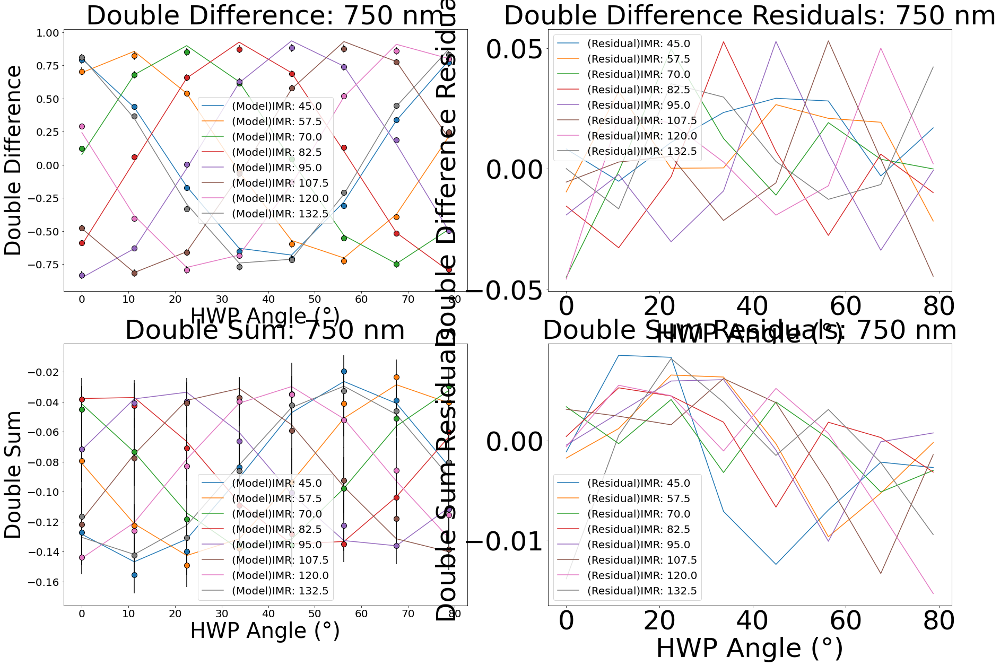

Post Likelihood: -1013.824446375203
Initial Likelihood: 108.70114226963825
Iteration #17: -1013.789763525456
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285248567342
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865453591102714
offset_derot (degrees): 5.0
delta_opts (waves): 0.34913147496983776
epsilon_opts: 1.8376864894933617e-11
rot_opts (degrees): 34.42347051295502
delta_FLC (waves): 0.4843034091057165
rot_FLC (degrees): 26.346073342259217
em_gain: 1.2005499616807231


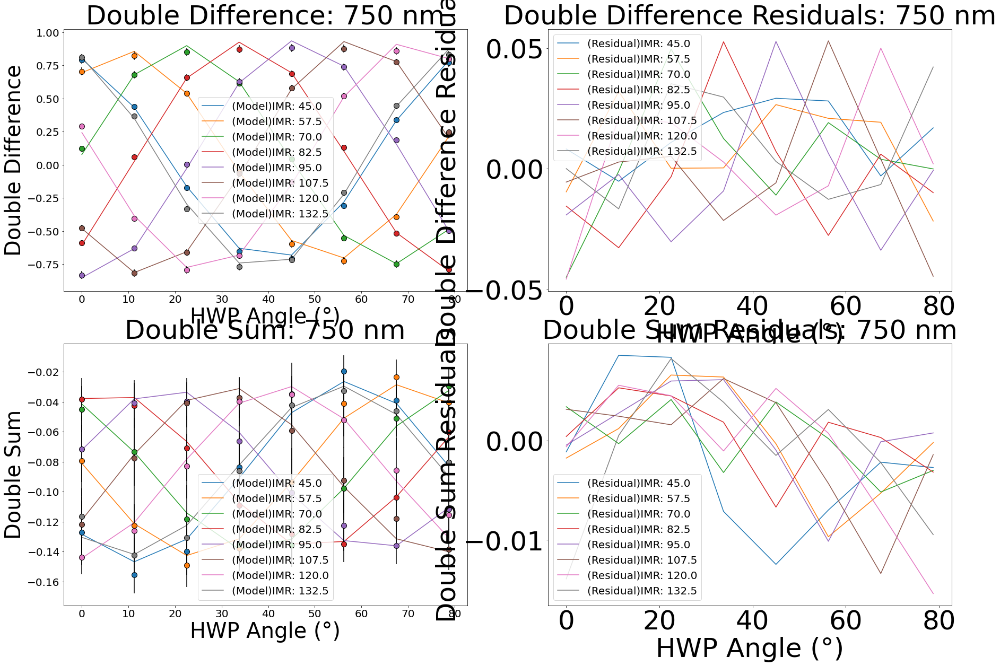

Post Likelihood: -1013.789763525456
Initial Likelihood: 108.70114226904192
Iteration #18: -1013.789763525456
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285248567342
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865453591102714
offset_derot (degrees): 5.0
delta_opts (waves): 0.34913147496983776
epsilon_opts: 1.8376864894933617e-11
rot_opts (degrees): 34.42347051295502
delta_FLC (waves): 0.4843034091057165
rot_FLC (degrees): 26.346073342259217
em_gain: 1.2005499616807231


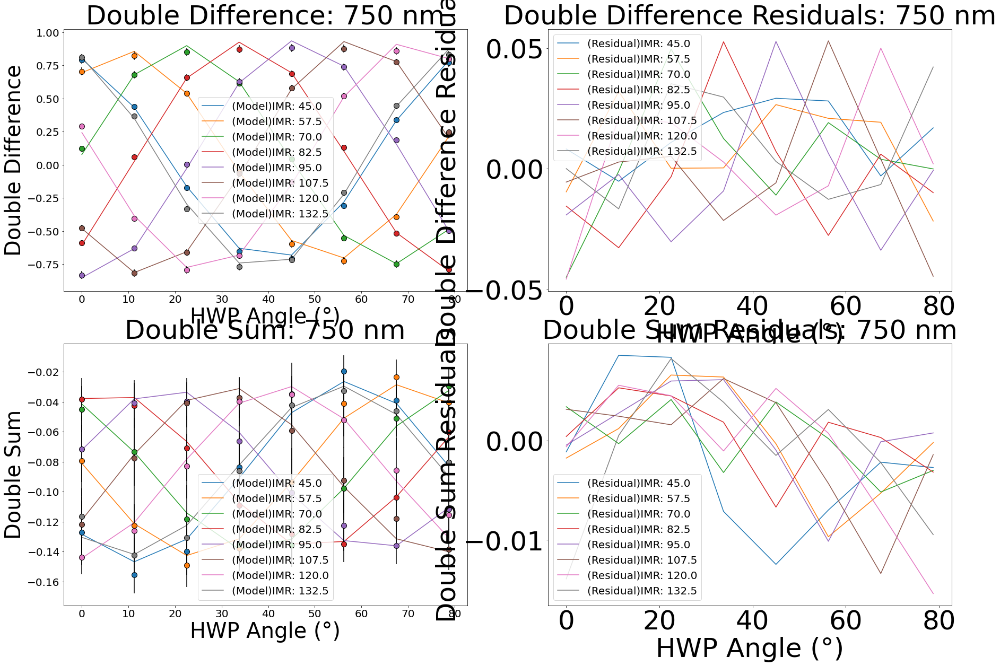

Post Likelihood: -1013.789763525456
Initial Likelihood: 108.70114226904192
Iteration #19: -1013.789763525456
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285248567342
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865453591102714
offset_derot (degrees): 5.0
delta_opts (waves): 0.34913147496983776
epsilon_opts: 1.8376864894933617e-11
rot_opts (degrees): 34.42347051295502
delta_FLC (waves): 0.4843034091057165
rot_FLC (degrees): 26.346073342259217
em_gain: 1.2005499616807231


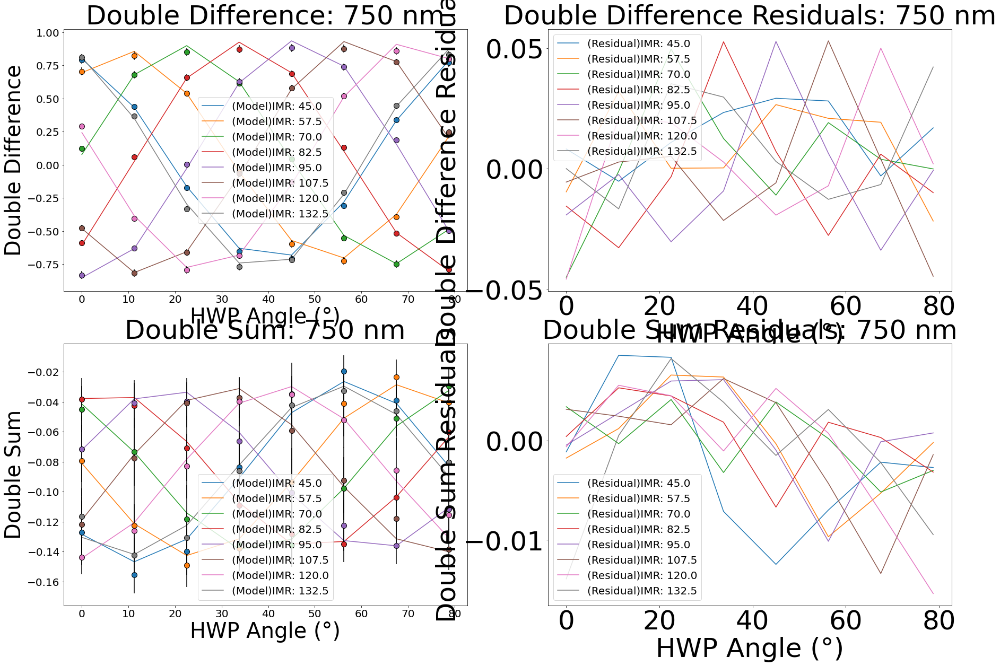

Post Likelihood: -1013.789763525456
Initial Likelihood: 108.70114226904192
Iteration #20: -1013.789763525456
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285248567342
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865453591102714
offset_derot (degrees): 5.0
delta_opts (waves): 0.34913147496983776
epsilon_opts: 1.8376864894933617e-11
rot_opts (degrees): 34.42347051295502
delta_FLC (waves): 0.4843034091057165
rot_FLC (degrees): 26.346073342259217
em_gain: 1.2005499616807231


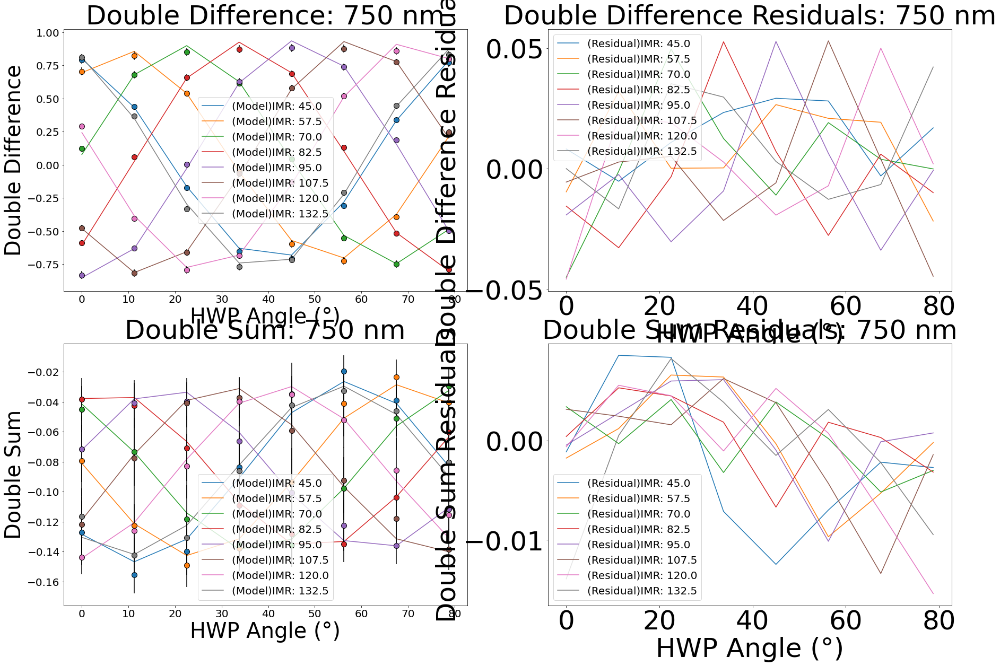

Post Likelihood: -1013.789763525456
Initial Likelihood: 108.70114226904192
Iteration #21: -1013.789763525456
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285248567342
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865453591102714
offset_derot (degrees): 5.0
delta_opts (waves): 0.34913147496983776
epsilon_opts: 1.8376864894933617e-11
rot_opts (degrees): 34.42347051295502
delta_FLC (waves): 0.4843034091057165
rot_FLC (degrees): 26.346073342259217
em_gain: 1.2005499616807231


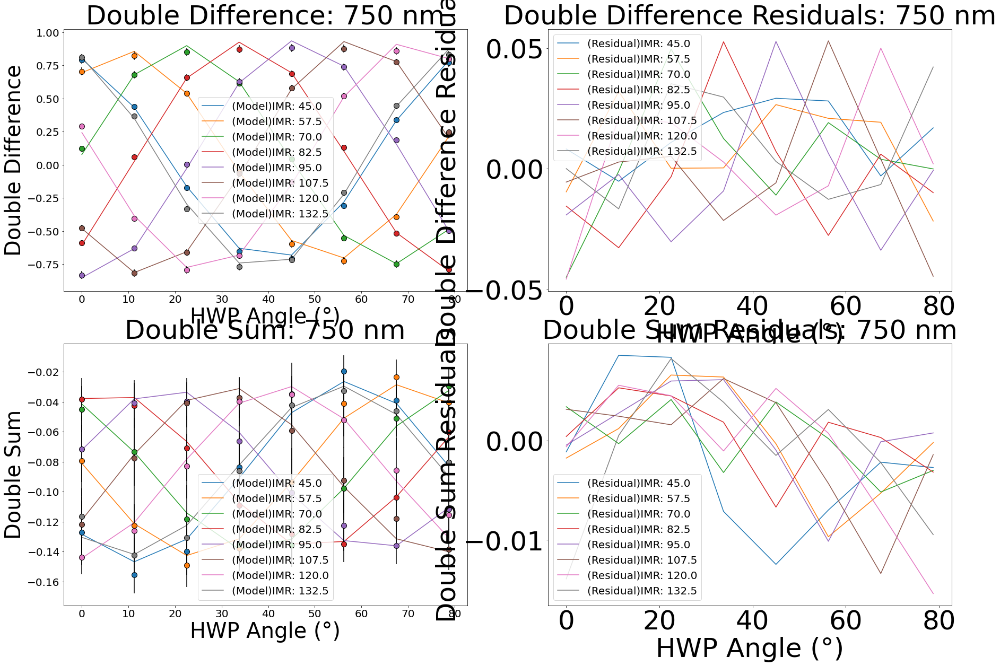

Post Likelihood: -1013.789763525456
Initial Likelihood: 108.70114226904192
Iteration #22: -1013.789763525456
MAXIMUM LIKELIHOOD ESTIMATES

theta_pol (degrees): -5.0
delta_HWP (waves): 0.4678285248567342
offset_HWP (degrees): -5.0
delta_derot (waves): 0.48865453591102714
offset_derot (degrees): 5.0
delta_opts (waves): 0.34913147496983776
epsilon_opts: 1.8376864894933617e-11
rot_opts (degrees): 34.42347051295502
delta_FLC (waves): 0.4843034091057165
rot_FLC (degrees): 26.346073342259217
em_gain: 1.2005499616807231


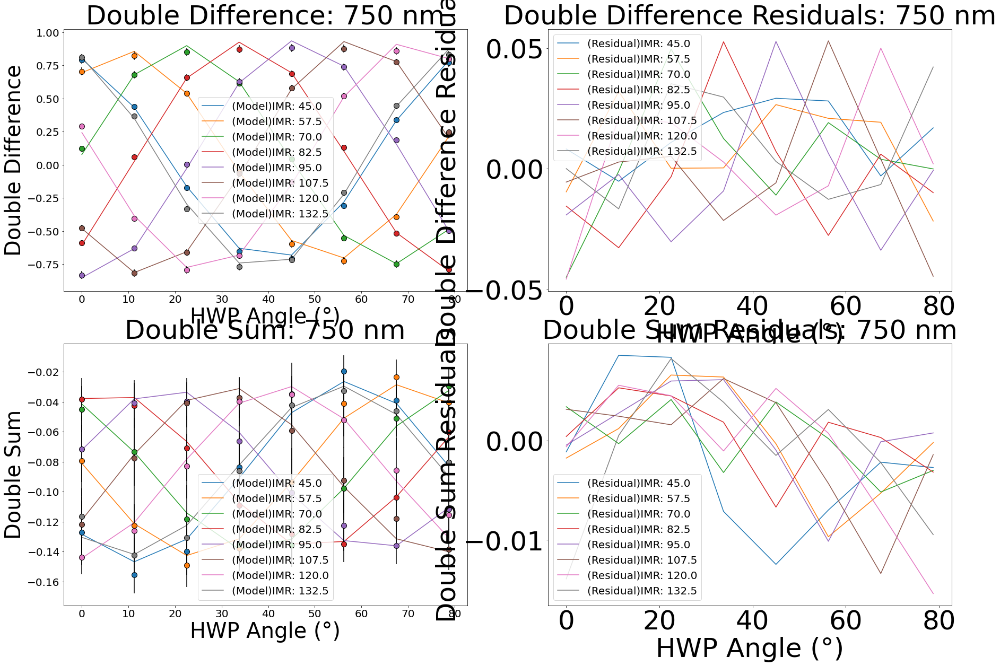

Post Likelihood: -1013.789763525456
Initial Likelihood: 108.70114226904192


KeyboardInterrupt: 

In [7]:
import numpy as np
from scipy.optimize import minimize

# Small value to remove error bars
log_f = -10

# Defining model angles
model_angles = np.linspace(0, 90, 100)

# List to store all the solutions 
solns = []

# Initial guess based on the parameters you want to minimize
initial_guess = np.array([theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, 
    delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain])

all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
    delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
    rot_FLC, em_gain]

# Fixed parameters not included in the fitting process
fixed_params = [delta_m3, epsilon_m3, offset_m3]

# Define the bounds for the parameters (including em_gain)
bounds = [
    (-5, 5),  # theta_pol
    (0, 0.5),  # delta_HWP
    (-5, 5),  # offset_HWP
    (0, 0.5),  # delta_derot
    (-5, 5),  # offset_derot
    (-0.5, 0.5),  # delta_opts
    (0, 0.1),  # epsilon_opts
    (-90, 90),  # rot_opts
    (0.4, 0.6),  # delta_FLC
    (-90, 90),  # rot_FLC
    (0, 2)  # em_gain
]

# Defining the negative log-likelihood function
def nll(params, model, HWP_angs, IMR_angs, data, stds):
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain = params
    delta_m3, epsilon_m3, offset_m3 = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    this_model = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals = this_model - data
    
    # Debug print shapes
    # print("Model shape:", this_model.shape)
    # print("Data shape:", data.shape)
    # print("Stds shape:", stds.shape)
    
    likelihood = np.sum((residuals / stds) ** 2)
    return likelihood

# Initialize variables for the iterative minimization process
counter = 0
initial_likelihood = 100
post_likelihood = 90

# Starting off with the initial guess
model = instrument_matrices.full_system_mueller_matrix
initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)

while post_likelihood < initial_likelihood:
    counter += 1

    initial_likelihood = post_likelihood

    # Calculate the initial model and residuals
    initial_model = -instrument_matrices.internal_calibration_mueller_matrix(initial_guess[0], model, all_params, HWP_angs, IMR_angs)
    initial_residuals = initial_model - reshaped_data

    initial_likelihood = np.sum((initial_residuals / reshaped_stds) ** 2)

    print("Initial Likelihood: " + str(initial_likelihood))

    # Minimize the negative log-likelihood
    minimize_args = (model, HWP_angs, IMR_angs, reshaped_data, reshaped_stds)
    soln = minimize(nll, initial_guess, args=minimize_args, bounds=bounds, method="Nelder-Mead")

    # Save the solution
    solns.append(soln)

    # Recalculate the likelihood with the new solution
    theta_pol, delta_HWP, offset_HWP, delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, rot_FLC, em_gain = soln.x
    delta_m3, epsilon_m3, offset_m3 = fixed_params
    all_params = [delta_m3, epsilon_m3, offset_m3, delta_HWP, offset_HWP, 
        delta_derot, offset_derot, delta_opts, epsilon_opts, rot_opts, delta_FLC, 
        rot_FLC, em_gain]
    post_likelihood = np.sum((-instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs) - reshaped_data) / reshaped_stds ** 2)

    print("Iteration #" + str(counter) + ": " + str(post_likelihood))

    print("MAXIMUM LIKELIHOOD ESTIMATES")
    print("")
    print("theta_pol (degrees): " + str(theta_pol))
    print("delta_HWP (waves): " + str(delta_HWP))
    print("offset_HWP (degrees): " + str(offset_HWP))
    print("delta_derot (waves): " + str(delta_derot))
    print("offset_derot (degrees): " + str(offset_derot))
    print("delta_opts (waves): " + str(delta_opts))
    print("epsilon_opts: " + str(epsilon_opts))
    print("rot_opts (degrees): " + str(rot_opts))
    print("delta_FLC (waves): " + str(delta_FLC))
    print("rot_FLC (degrees): " + str(rot_FLC))
    print("em_gain: " + str(em_gain))

    reshaped_data = general.reshape_and_flatten(data)
    reshaped_stds = general.reshape_and_flatten(stds)

    model_1 = -instrument_matrices.internal_calibration_mueller_matrix(theta_pol, model, all_params, HWP_angs, IMR_angs)
    residuals_1 = model_1 - reshaped_data

    data_plotting.plot_single_model_and_residuals(angles, angles, model_1, data, 
        residuals_1, stds, log_f, wavelength, fig_dimensions = (30, 20))

    # Reset initial guess
    initial_guess = soln.x

    print("Post Likelihood: " + str(post_likelihood))

print("End of Optimization")
